# Capstone Project - Invest candidate in Seoul
### Applied Data Science Capstone by IBM/Coursera

## 1. Introduction: Business Problem

In this project, I will try to find a candidate for real property investment in **Seoul**, the capital of South Korea. The target of this project is investors who want to find underestimated areas in Seoul.

Seoul has **25 districts("gu")** and **467 neighborhoods("dong")**. To characterize each neighborhood, I will use the Foursquare location data. I will try to find a few neighborhoods those have similar characteristics of areas whose public land prices (KRW/square meter) are expensive, but the lands value is relatively cheap. There would be reasons why the land price of neighborhood is cheap, such as bad public transportation, no schools nearby, etc. But I assume that those kind of weak points would be overcome in the future.

I will use data science methodology to find the best investment candidates. For example, I may be able to find some undervalued neighborhood which has very similar to Gangnam area.


## 2. Data

To solve the problem, I need following information.

* Geospatial Coordinates of each neighborhood in Seoul
* Average land price of each neighborhood in Seoul

I can obtain information above from the website Seoul Metropolitan Government.

* Geospatial coordination of neighborhoods in Seoul 
(http://data.seoul.go.kr/dataList/OA-13221/S/1/datasetView.do)   
> The csv file contains **neighborhood'code(읍면동코드)** and **name(읍면동명)**, **latitudes(위도)** and **longitudes(경도)**.
* Annual standard land price of Seoul 
(http://data.seoul.go.kr/dataList/OA-1180/F/1/datasetView.do)
> The xls file contains **district's name(SIGUNGU_NM)** and **code(SGG_CD)** and **neighborhood's name(BJDONG_NAME)** and **code(BJDONG_CD)** and **standard price(JIGA)** of each address.   
* Venues of each neighborhood of Seoul obtained via Foursquare API


## 3. Methodology

In this project, I will cluster neighborhoods in Seoul based on the proportion of venue categories from the Foursquare API.  
After that, I will find out the most expensive cluster in Seoul and I will choose several investment candidates where the land price is low. 

### Import Libraries

In [1]:
import pandas as pd
import numpy as np
from sklearn import preprocessing
import matplotlib.pyplot as plt
import folium
import requests
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import matplotlib.colors as colors


#### At first, Download Geospatial coordination csv file. 
I downloaded a csv file("서울시 법정구역 읍면동 공간정보 (좌표계_ WGS1984).csv") from data.seoul.go.kr website.  
And I loaded to the df_geo dataframe.


In [2]:
df_geo = pd.read_csv("서울시 법정구역 읍면동 공간정보 (좌표계_ WGS1984).csv",encoding='CP949')
df_geo.columns=['Number','Neighbor_CD','Neighbor_NM_KOR','Neighbor_NM','Latitude','Longitude']
df_geo['SGG_CD']=(df_geo['Neighbor_CD']/1000).astype('int')
df_geo['BJDONG_CD']=((df_geo['Neighbor_CD']%1000)*100).astype('int')
df_geo['Neighbor_CD'] = df_geo['Neighbor_CD'].astype('int64').astype('str')
df_geo.head()

,Number,Neighbor_CD,Neighbor_NM_KOR,Neighbor_NM,Latitude,Longitude,SGG_CD,BJDONG_CD
0,76,11140108,수하동,Suha-dong,37.567417,126.984642,11140,10800
1,84,11140102,다동,Da-dong,37.567883,126.981194,11140,10200
2,85,11230107,청량리동,Cheongnyangni-dong,37.588315,127.046090,11230,10700
3,86,11230110,이문동,Imun-dong,37.599401,127.062471,11230,11000
4,87,11260106,신내동,Sinnae-dong,37.610252,127.101155,11260,10600


In [3]:
# create map of Seoul
map_seoul = folium.Map(location=[37.5665, 126.9780], zoom_start=12)

# add markers to map
for lat, lng, borough, neighborhood in zip(df_geo['Latitude'], df_geo['Longitude'], df_geo['SGG_CD'], df_geo['Neighbor_NM']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_seoul)  
    
map_seoul

#### Then, Download Land Price xls file. 
I downloaded a xlsx file("공시지가_2019년") from data.seoul.go.kr website.  
The xlsx file contains land prices of **916,873** addresses in **467** neighborhoods. 


In [4]:
df = pd.read_excel("공시지가_2019년.xlsx")

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 916873 entries, 0 to 916872
Data columns (total 13 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   SIDO_NM      916873 non-null  object        
 1   SIGUNGU_NM   916873 non-null  object        
 2   BJDONG_NM    916873 non-null  object        
 3   LAND_CD      916873 non-null  object        
 4   JIGA         916873 non-null  int64         
 5   SGG_CD       916873 non-null  int64         
 6   BJDONG_CD    916873 non-null  int64         
 7   LAND_GBN     916872 non-null  float64       
 8   LAND_GBN_NM  916872 non-null  object        
 9   BOBN         916873 non-null  object        
 10  BUBN         916873 non-null  object        
 11  YEAR         916873 non-null  int64         
 12  BASE_MON     916873 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(1), int64(4), object(7)
memory usage: 66.5+ MB


In [6]:
df.head()

,SIDO_NM,SIGUNGU_NM,BJDONG_NM,LAND_CD,JIGA,SGG_CD,BJDONG_CD,LAND_GBN,LAND_GBN_NM,BOBN,BUBN,YEAR,BASE_MON
0,서울특별시,종로구,청운동,1111010100100010000,3961000,11110,10100,1.0,일반,0001,0000,2019,2019-01-01
1,서울특별시,종로구,청운동,1111010100100010001,1296000,11110,10100,1.0,일반,0001,0001,2019,2019-01-01
2,서울특별시,종로구,청운동,1111010100100010002,3267000,11110,10100,1.0,일반,0001,0002,2019,2019-01-01
3,서울특별시,종로구,청운동,1111010100100010003,4255000,11110,10100,1.0,일반,0001,0003,2019,2019-01-01
4,서울특별시,종로구,청운동,1111010100100010004,1524000,11110,10100,1.0,일반,0001,0004,2019,2019-01-01


Add **Neighbor_CD** column to the dataframe.

In [7]:
df['Neighbor_CD'] = ((df['SGG_CD']*100000+df['BJDONG_CD'])/100).astype('int64').astype('str')

In [8]:
df.head()

,SIDO_NM,SIGUNGU_NM,BJDONG_NM,LAND_CD,JIGA,SGG_CD,BJDONG_CD,LAND_GBN,LAND_GBN_NM,BOBN,BUBN,YEAR,BASE_MON,Neighbor_CD
0,서울특별시,종로구,청운동,1111010100100010000,3961000,11110,10100,1.0,일반,0001,0000,2019,2019-01-01,11110101
1,서울특별시,종로구,청운동,1111010100100010001,1296000,11110,10100,1.0,일반,0001,0001,2019,2019-01-01,11110101
2,서울특별시,종로구,청운동,1111010100100010002,3267000,11110,10100,1.0,일반,0001,0002,2019,2019-01-01,11110101
3,서울특별시,종로구,청운동,1111010100100010003,4255000,11110,10100,1.0,일반,0001,0003,2019,2019-01-01,11110101
4,서울특별시,종로구,청운동,1111010100100010004,1524000,11110,10100,1.0,일반,0001,0004,2019,2019-01-01,11110101


I build a new dataframe for **Average Land Price** of each neighborhood.

In [9]:
df_avg_price = df.groupby(['Neighbor_CD'],as_index=False).mean()
df_avg_price['JIGA'] = df_avg_price['JIGA'].astype('int')
df_avg_price['Neighbor_CD'].astype('int64').astype('str')
df_avg_price.drop(columns=['SGG_CD','BJDONG_CD','LAND_GBN','YEAR'], inplace=True)
df_avg_price.head()

,Neighbor_CD,JIGA
0,11110101,2753689
1,11110102,2848254
2,11110103,3279504
3,11110104,3718633
4,11110105,4153525


Merge two dataframes.

In [10]:
df_merged = pd.merge(df_geo,df_avg_price)
df_merged.head()

,Number,Neighbor_CD,Neighbor_NM_KOR,Neighbor_NM,Latitude,Longitude,SGG_CD,BJDONG_CD,JIGA
0,76,11140108,수하동,Suha-dong,37.567417,126.984642,11140,10800,21067642
1,84,11140102,다동,Da-dong,37.567883,126.981194,11140,10200,21260062
2,85,11230107,청량리동,Cheongnyangni-dong,37.588315,127.046090,11230,10700,3111159
3,86,11230110,이문동,Imun-dong,37.599401,127.062471,11230,11000,2890170
4,87,11260106,신내동,Sinnae-dong,37.610252,127.101155,11260,10600,1394616


In [ ]:
df_merged[df_merged['Neighbor_NM']=='Sinsa-dong']

In [11]:
df_merged['JIGA'].describe()

count    4.670000e+02
mean     6.125230e+06
std      6.851746e+06
min      1.663790e+05
25%      2.916439e+06
50%      3.983670e+06
75%      6.542364e+06
max      6.932049e+07
Name: JIGA, dtype: float64

Let's look at the histogram of **Land Price**.

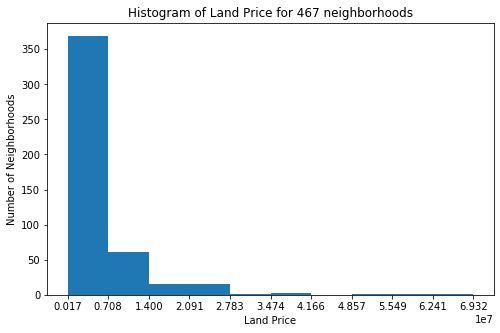

In [12]:
count, bin_edges = np.histogram(df_merged['JIGA'])

df_merged['JIGA'].plot(kind='hist',figsize=(8,5),xticks = bin_edges)
plt.title("Histogram of Land Price for 467 neighborhoods")
plt.ylabel('Number of Neighborhoods')
plt.xlabel('Land Price')
plt.show()

In [14]:
print( count)
print(bin_edges)

[369  61  16  15   1   2   0   1   1   1]
[  166379.   7081790.2 13997201.4 20912612.6 27828023.8 34743435.
 41658846.2 48574257.4 55489668.6 62405079.8 69320491. ]


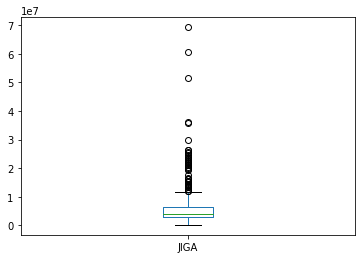

In [13]:
df_sorted = df_merged.sort_values('JIGA',ascending=True).reset_index()
df_sorted['JIGA'].plot(kind='box')

I found that the average land price of 469 neighborhoods are cheaper than 7081790 KRW/m<sup>2</sup> and there are several very expensive neighborhoods in Seoul.

Let's examine 50 most expensive neighborhoods. 

In [15]:
df_expensive = df_merged.sort_values('JIGA',ascending=False)[:50]
df_expensive.groupby('SGG_CD').count()

,Number,Neighbor_CD,Neighbor_NM_KOR,Neighbor_NM,Latitude,Longitude,BJDONG_CD,JIGA
SGG_CD,,,,,,,,
11110,19,19,19,19,19,19,19,19
11140,29,29,29,29,29,29,29,29
11680,2,2,2,2,2,2,2,2


The SGG_CG of 48 neighborhoods are **11140** and **11110**. SGG_CD 11140 is **Jung-gu** and SSG_CD 11110 is **Jongno-gu**, respectively. These districs are the downtown of Seoul.
The reason why these districs are very expensive is mainly because of the geographycal location. I will exclude these two districts for my analysis because the locations of neighborhoods can not be changed in the future.

I create a new dataframe called **df_filtered** which does not contain Jung-gu and Jongro-gu.

In [16]:
df_filtered = df_merged[df_merged['SGG_CD'] != 11110]
df_filtered = df_filtered[df_filtered['SGG_CD'] != 11140]
df_filtered.reset_index()
df_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 306 entries, 2 to 466
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Number           306 non-null    int64  
 1   Neighbor_CD      306 non-null    object 
 2   Neighbor_NM_KOR  306 non-null    object 
 3   Neighbor_NM      306 non-null    object 
 4   Latitude         306 non-null    float64
 5   Longitude        306 non-null    float64
 6   SGG_CD           306 non-null    int32  
 7   BJDONG_CD        306 non-null    int32  
 8   JIGA             306 non-null    int32  
dtypes: float64(2), int32(3), int64(1), object(3)
memory usage: 16.7+ KB


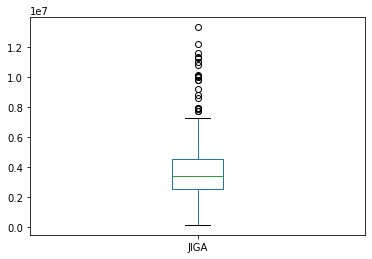

In [17]:
df_filtered['JIGA'].describe()
df_filtered['JIGA'].plot(kind='box')

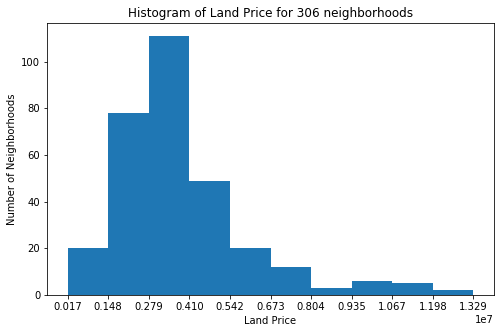

In [18]:
count, bin_edges = np.histogram(df_filtered['JIGA'])

df_filtered['JIGA'].plot(kind='hist',figsize=(8,5),xticks = bin_edges)
plt.title("Histogram of Land Price for 306 neighborhoods")
plt.ylabel('Number of Neighborhoods')
plt.xlabel('Land Price')
plt.show()

In [19]:
# create map of Seoul
map_seoul = folium.Map(location=[37.5665, 126.9780], zoom_start=12)

# add markers to map
for lat, lng,  neighborhood in zip(df_filtered['Latitude'], df_filtered['Longitude'], df_filtered['Neighbor_NM']):
    label = neighborhood
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_seoul)  
    
map_seoul

#### Let's look at the map.

#### Get geojson file.

I downloaded neighborhood SHP file of Seoul(https://data.seoul.go.kr/dataList/OA-13221/F/1/datasetView.do)

Then transform to GeoJSON at https://mygeodata.cloud/

In [20]:
geo_seoul = r'TC_SPBE17_2015_W.geojson'

In [21]:
# create map of Seoul
map_seoul = folium.Map(location=[37.5665, 126.9780], zoom_start=11)

bins = list(df_filtered.sort_values(['JIGA'])['JIGA'])
bins[-1]=bins[-1]+1
bin = bins[::35]
bin.append(df_filtered['JIGA'].max()+1)
print(bin)
folium.Choropleth(
    geo_data = geo_seoul,
    data = df_filtered,
    columns = ['Neighbor_CD','JIGA'],
    key_on = 'feature.properties.EMD_CD',
    fill_color = 'YlOrRd',
    fill_opacity = 0.7,
    line_opacity = 0.2,
    nan_fill_color='black',
    nan_fill_opacity=0.7,
    bins=bin,
    legend_name = 'Price',
    reset=True
).add_to(map_seoul)
    
map_seoul

[166379, 1953691, 2505461, 2934205, 3284748, 3631369, 4160606, 4844768, 6979536, 13290395]


c:\program files (x86)\python38-32\lib\site-packages\branca\colormap.py:92: RuntimeWarning: overflow encountered in long_scalars
  self.color_domain = [self.vmin + (self.vmax-self.vmin) * k/499. for


# Explore and cluster the neighborhoods in Seoul

In [22]:
seoul_data = df_filtered
seoul_data.head()

,Number,Neighbor_CD,Neighbor_NM_KOR,Neighbor_NM,Latitude,Longitude,SGG_CD,BJDONG_CD,JIGA
2,85,11230107,청량리동,Cheongnyangni-dong,37.588315,127.046090,11230,10700,3111159
3,86,11230110,이문동,Imun-dong,37.599401,127.062471,11230,11000,2890170
4,87,11260106,신내동,Sinnae-dong,37.610252,127.101155,11260,10600,1394616
7,97,11215109,군자동,Gunja-dong,37.553242,127.073492,11215,10900,3450211
8,5,11170105,남영동,Namyeong-dong,37.542850,126.973390,11170,10500,9982836


#### Define Foursquare Credentials and version

In [23]:
CLIENT_ID = '5O0JG3RPBEEGEAD3JHJSBYDKS0MASFLJSKWGJ1YICWMCOFNW' # your Foursquare ID
CLIENT_SECRET = 'HFMDN24IEABZOSILAQBAXCDBHDR4O04RBH1UKBNOKCDOAFVJ' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

CLIENT_ID: 5O0JG3RPBEEGEAD3JHJSBYDKS0MASFLJSKWGJ1YICWMCOFNW
CLIENT_SECRET:HFMDN24IEABZOSILAQBAXCDBHDR4O04RBH1UKBNOKCDOAFVJ


In [24]:
LIMIT = 100 # limit of number of venues returned by Foursquare API
radius = 500 # define radius

In [25]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
  
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
  
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

### Code to run the above function on each neighborhood and create a new dataframe called seoul_venues.

In [ ]:
seoul_venues = getNearbyVenues(names=seoul_data['Neighbor_CD'],
                                   latitudes=seoul_data['Latitude'],
                                   longitudes=seoul_data['Longitude']
                                  )

#### Let's check the size of the resulting dataframe

In [27]:
print(seoul_venues.shape)
seoul_venues.head()

(6097, 8)


,Unnamed: 0,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,0,11230107,37.588315,127.04609,영휘원·숭인원 (Yeonghwiwon & Sunginwon),37.587966,127.044955,Historic Site
1,1,11230107,37.588315,127.04609,ALOCASIA,37.591561,127.048849,Café
2,2,11230107,37.588315,127.04609,홍릉수목원 (국립산림과학원),37.591925,127.043024,Forest
3,3,11230107,37.588315,127.04609,홍릉갈비,37.586719,127.042684,Korean Restaurant
4,4,11230107,37.588315,127.04609,세종대왕기념관,37.590490,127.043569,History Museum


#### One hot encoding for each venues.

In [28]:
# one hot encoding
seoul_onehot = pd.get_dummies(seoul_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
seoul_onehot['Neighborhood'] = seoul_venues['Neighborhood'] 

# move neighborhood column to the first column
cols=list(seoul_onehot.columns.values)
cols.pop(cols.index('Neighborhood'))
seoul_onehot=seoul_onehot[['Neighborhood']+cols]

# rename Neighborhood for Neighbourhood so that future merge works
seoul_onehot.rename(columns = {'Neighborhood': 'Neighbourhood'}, inplace = True)
seoul_onehot.head()

,Neighbourhood,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,...,Warehouse Store,Water Park,Waterfall,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Zoo
0,11230107,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,11230107,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,11230107,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,11230107,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,11230107,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [29]:
seoul_onehot.shape

(6097, 260)

In [30]:
seoul_grouped = seoul_onehot.groupby('Neighbourhood').mean().reset_index()
seoul_grouped

,Neighbourhood,Airport Terminal,American Restaurant,Arcade,Art Gallery,Art Museum,Arts & Crafts Store,Arts & Entertainment,Asian Restaurant,Athletics & Sports,...,Warehouse Store,Water Park,Waterfall,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio,Zoo
0,11170101,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.000000,0.034483,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
1,11170102,0.0,0.0,0.000000,0.00000,0.0,0.017857,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
2,11170103,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.021739,0.0,0.0,0.0
3,11170104,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.000000,0.022727,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
4,11170105,0.0,0.0,0.000000,0.03125,0.0,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,11740106,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
301,11740107,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
302,11740108,0.0,0.0,0.000000,0.00000,0.0,0.000000,0.076923,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
303,11740109,0.0,0.0,0.052632,0.00000,0.0,0.000000,0.000000,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0


In [31]:
seoul_grouped.shape

(305, 260)

#### Printing each neighborhood along with the top 5 most common venues

In [32]:
num_top_venues = 5

for hood in seoul_grouped['Neighbourhood']:
    print("----"+str(hood)+"----")
    temp = seoul_grouped[seoul_grouped['Neighbourhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----11170101----
                venue  freq
0         Coffee Shop  0.17
1   Korean Restaurant  0.14
2           BBQ Joint  0.10
3              Bakery  0.07
4  Italian Restaurant  0.07


----11170102----
         venue  freq
0         Café  0.09
1          Pub  0.07
2    BBQ Joint  0.07
3  Coffee Shop  0.05
4       Bistro  0.05


----11170103----
         venue  freq
0  Coffee Shop  0.09
1          Bar  0.04
2   Steakhouse  0.04
3  Pizza Place  0.04
4         Café  0.04


----11170104----
               venue  freq
0        Coffee Shop  0.18
1  Korean Restaurant  0.16
2          BBQ Joint  0.07
3    Thai Restaurant  0.05
4             Bakery  0.05


----11170105----
               venue  freq
0        Coffee Shop  0.19
1  Korean Restaurant  0.12
2          BBQ Joint  0.06
3             Bakery  0.06
4       Noodle House  0.03


----11170106----
               venue  freq
0  Korean Restaurant  0.21
1        Coffee Shop  0.16
2         Food Court  0.05
3        Art Gallery  0.05
4        

#### function to sort the venues in descending order.

In [33]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

#### create the new dataframe and display the top 10 venues for each neighborhood.

In [34]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighbourhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighbourhood'] = seoul_grouped['Neighbourhood']

for ind in np.arange(seoul_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(seoul_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted

,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,11170101,Coffee Shop,Korean Restaurant,BBQ Joint,Italian Restaurant,Bakery,Burger Joint,Bus Stop,Café,Breakfast Spot,Noodle House
1,11170102,Café,BBQ Joint,Pub,Bistro,Coffee Shop,Cocktail Bar,Bar,Vietnamese Restaurant,Burger Joint,Lounge
2,11170103,Coffee Shop,Bar,Nightclub,Café,Pizza Place,BBQ Joint,Steakhouse,Mexican Restaurant,Korean Restaurant,Buffet
3,11170104,Coffee Shop,Korean Restaurant,BBQ Joint,Donut Shop,Bakery,Thai Restaurant,Noodle House,Sushi Restaurant,Steakhouse,Bubble Tea Shop
4,11170105,Coffee Shop,Korean Restaurant,Bakery,BBQ Joint,Ice Cream Shop,Fast Food Restaurant,Bubble Tea Shop,Bunsik Restaurant,Noodle House,Chinese Restaurant
...,...,...,...,...,...,...,...,...,...,...,...
300,11740106,Korean Restaurant,Trail,Metro Station,Farmers Market,Exhibit,Farm,Fast Food Restaurant,Fish Market,Zoo,Event Space
301,11740107,Coffee Shop,History Museum,Korean Restaurant,Flea Market,Exhibit,Farm,Farmers Market,Fast Food Restaurant,Fish Market,Zoo
302,11740108,Coffee Shop,Korean Restaurant,Sporting Goods Shop,Arts & Entertainment,Chinese Restaurant,Shabu-Shabu Restaurant,Bakery,Park,Japanese Restaurant,Flower Shop
303,11740109,Coffee Shop,Café,Park,Steakhouse,Arcade,Ramen Restaurant,Bookstore,Japanese Restaurant,Dumpling Restaurant,Restaurant


# Run *k*-means to cluster the neighborhood

### Elbow Test for number of clusters

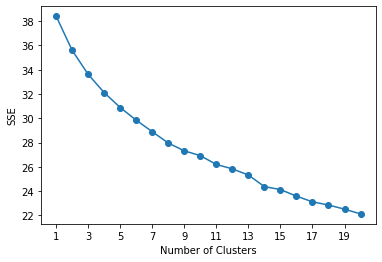

In [36]:
def elbow(X):
    sse = []
    for i in range (1,21):
        km = KMeans(n_clusters=i, random_state=0).fit(X)
        sse.append(km.inertia_)
    plt.plot(range(1,21), sse, marker = 'o')
    plt.xlabel('Number of Clusters')
    plt.xticks(np.arange(1,20,step=2))
    plt.ylabel('SSE')
    plt.show()

seoul_grouped_clustering = seoul_grouped.drop('Neighbourhood', 1)

elbow(seoul_grouped_clustering)

### Cluster into 14 clusters

In [37]:
# set number of clusters
kclusters = 14

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(seoul_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

array([6, 6, 6, 6, 6, 6, 6, 0, 6, 6])

In [38]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)
neighborhoods_venues_sorted.head()

,Cluster Labels,Neighbourhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,6,11170101,Coffee Shop,Korean Restaurant,BBQ Joint,Italian Restaurant,Bakery,Burger Joint,Bus Stop,Café,Breakfast Spot,Noodle House
1,6,11170102,Café,BBQ Joint,Pub,Bistro,Coffee Shop,Cocktail Bar,Bar,Vietnamese Restaurant,Burger Joint,Lounge
2,6,11170103,Coffee Shop,Bar,Nightclub,Café,Pizza Place,BBQ Joint,Steakhouse,Mexican Restaurant,Korean Restaurant,Buffet
3,6,11170104,Coffee Shop,Korean Restaurant,BBQ Joint,Donut Shop,Bakery,Thai Restaurant,Noodle House,Sushi Restaurant,Steakhouse,Bubble Tea Shop
4,6,11170105,Coffee Shop,Korean Restaurant,Bakery,BBQ Joint,Ice Cream Shop,Fast Food Restaurant,Bubble Tea Shop,Bunsik Restaurant,Noodle House,Chinese Restaurant


#### Merge **Neighbour** dataframe and **Venues_sorted** dataframe.

In [39]:
seoul_merged = seoul_data

# merge seoul_grouped with seoul_data to add latitude/longitude for each neighborhood
neighborhoods_venues_sorted['Neighbourhood'] = neighborhoods_venues_sorted['Neighbourhood'].astype('str')
seoul_merged = seoul_merged.join(neighborhoods_venues_sorted.set_index('Neighbourhood'), on='Neighbor_CD')

# drop rows with no venues, no cluster labels
seoul_merged.dropna(axis=0,inplace=True)
seoul_merged['Cluster Labels'] = seoul_merged['Cluster Labels'].astype('int64') 
seoul_merged.head()


,Number,Neighbor_CD,Neighbor_NM_KOR,Neighbor_NM,Latitude,Longitude,SGG_CD,BJDONG_CD,JIGA,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
2,85,11230107,청량리동,Cheongnyangni-dong,37.588315,127.046090,11230,10700,3111159,7,Korean Restaurant,Café,Japanese Restaurant,Historic Site,History Museum,Forest,Park,Food,Flower Shop,Flea Market
3,86,11230110,이문동,Imun-dong,37.599401,127.062471,11230,11000,2890170,6,Coffee Shop,Café,Korean Restaurant,Supermarket,Ice Cream Shop,Metro Station,Bakery,Chinese Restaurant,Burger Joint,Bus Station
4,87,11260106,신내동,Sinnae-dong,37.610252,127.101155,11260,10600,1394616,4,Korean Restaurant,Metro Station,Noodle House,Zoo,Farm,Farmers Market,Fast Food Restaurant,Fish Market,Flea Market,Flower Shop
7,97,11215109,군자동,Gunja-dong,37.553242,127.073492,11215,10900,3450211,2,Chinese Restaurant,Coffee Shop,Bakery,Museum,Chocolate Shop,Ice Cream Shop,Café,Farmers Market,Fast Food Restaurant,Fish Market
8,5,11170105,남영동,Namyeong-dong,37.542850,126.973390,11170,10500,9982836,6,Coffee Shop,Korean Restaurant,Bakery,BBQ Joint,Ice Cream Shop,Fast Food Restaurant,Bubble Tea Shop,Bunsik Restaurant,Noodle House,Chinese Restaurant


In [40]:
seoul_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 305 entries, 2 to 466
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Number                  305 non-null    int64  
 1   Neighbor_CD             305 non-null    object 
 2   Neighbor_NM_KOR         305 non-null    object 
 3   Neighbor_NM             305 non-null    object 
 4   Latitude                305 non-null    float64
 5   Longitude               305 non-null    float64
 6   SGG_CD                  305 non-null    int32  
 7   BJDONG_CD               305 non-null    int32  
 8   JIGA                    305 non-null    int32  
 9   Cluster Labels          305 non-null    int64  
 10  1st Most Common Venue   305 non-null    object 
 11  2nd Most Common Venue   305 non-null    object 
 12  3rd Most Common Venue   305 non-null    object 
 13  4th Most Common Venue   305 non-null    object 
 14  5th Most Common Venue   305 non-null    ob

#### Let's look at the clusters.

In [41]:
seoul_merged.groupby('Cluster Labels',as_index=False)['Number','JIGA'].count()

<ipython-input-41-7c191dafe0f3>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  seoul_merged.groupby('Cluster Labels',as_index=False)['Number','JIGA'].count()


,Cluster Labels,Number,JIGA
0,0,17,17
1,1,36,36
2,2,17,17
3,3,3,3
4,4,12,12
5,5,1,1
6,6,99,99
7,7,50,50
8,8,10,10
9,9,2,2


# Visualize the resulting clusters

In [42]:
# create map
map_clusters = folium.Map(location=[37.5665, 126.9780], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(seoul_merged['Latitude'], seoul_merged['Longitude'], seoul_merged['Neighbor_NM'], seoul_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

## Examine Clusters

In [43]:
seoul_merged[['JIGA','Cluster Labels']].groupby('Cluster Labels').describe()

JIGA                                                     \
               count          mean           std        min         25%   
Cluster Labels                                                            
0               17.0  2.472961e+06  9.010892e+05   350000.0  2252250.00   
1               36.0  3.189269e+06  1.445453e+06   379601.0  2370522.25   
2               17.0  2.866357e+06  8.741688e+05   679742.0  2550468.00   
3                3.0  2.882156e+06  1.410147e+06  1756245.0  2091326.50   
4               12.0  2.477687e+06  1.788740e+06   166379.0  1439856.75   
5                1.0  1.477851e+06           NaN  1477851.0  1477851.00   
6               99.0  5.315552e+06  2.636837e+06  1659649.0  3529316.00   
7               50.0  3.655728e+06  1.515785e+06  1152576.0  2829696.00   
8               10.0  2.180593e+06  9.191138e+05   731268.0  1635327.75   
9                2.0  1.739062e+06  1.724585e+06   519597.0  1129329.75   
10              49.0  3.514322e+06  1.293392e+06   204200.0  2724537.00   
11               3.0  2.837250e+06  3.104836e+05  2580177.0  2664775.00   
12               1.0  1.684480e+05           NaN   168448.0   168448.00   
13               5.0  4.141624e+06  9.950999e+05  3220410.0  3284748.00   

                                                   
                      50%         75%         max  
Cluster Labels                                     
0               2528762.0  2783310.00   4577571.0  
1               3060329.5  3926404.75   7944870.0  
2               2948846.0  3183300.00   4480626.0  
3               2426408.0  3445111.50   4463815.0  
4               2337414.5  2691486.00   7258678.0  
5               1477851.0  1477851.00   1477851.0  
6               4474408.0  6401429.00  13290394.0  
7               3397082.5  4130404.75  10052447.0  
8               2060103.0  2695624.25   3854158.0  
9               1739062.5  2348795.25   2958528.0  
10              3417662.0  4184848.00   8611433.0  
11              2749373.0  2965787.00   3182201.0  
12               168448.0   168448.00    168448.0  
13              3869196.0  4849478.00   5484289.0

**Cluster Label 6** is the most expensive cluster in Seoul. The average land price is expensive than other clusters.

Let's check the top 20 neighborhoods.


In [44]:
seoul_merged.sort_values('JIGA', ascending=False)[:20].groupby('Cluster Labels').count()

,Number,Neighbor_CD,Neighbor_NM_KOR,Neighbor_NM,Latitude,Longitude,SGG_CD,BJDONG_CD,JIGA,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
Cluster Labels,,,,,,,,,,,,,,,,,,,
1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
6,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17,17
7,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
10,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


Among 20 most expensive neighborhoods, 17 neighborhoods are in **Cluster Labels 6**.

I will focus on **Cluster Label 6**. 

In [45]:
cluster_expensive = seoul_merged[seoul_merged['Cluster Labels'] == 6]
cluster_expensive.sort_values('JIGA',ascending=False,inplace=True)
cluster_expensive

<ipython-input-45-c191542b5b3c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cluster_expensive.sort_values('JIGA',ascending=False,inplace=True)


,Number,Neighbor_CD,Neighbor_NM_KOR,Neighbor_NM,Latitude,Longitude,SGG_CD,BJDONG_CD,JIGA,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
340,337,11680107,신사동,Sinsa-dong,37.522901,127.024655,11680,10700,13290394,6,Coffee Shop,Japanese Restaurant,Bakery,Korean Restaurant,Sake Bar,Cosmetics Shop,Italian Restaurant,Taco Place,BBQ Joint,Bar
447,453,11680104,청담동,Cheongdam-dong,37.525587,127.052275,11680,10400,12202373,6,BBQ Joint,Japanese Restaurant,Korean Restaurant,Café,Coffee Shop,Dessert Shop,Fried Chicken Joint,Italian Restaurant,Hotel,Bunsik Restaurant
311,393,11680105,삼성동,Samseong-dong,37.514797,127.055090,11680,10500,11576585,6,Korean Restaurant,Coffee Shop,Gym / Fitness Center,Multiplex,Japanese Restaurant,BBQ Joint,Food Court,Mexican Restaurant,Event Space,Chinese Restaurant
357,322,11560104,영등포동3가,Yeongdeungpo-dong 3(sam)-ga,37.518130,126.908400,11560,10400,11331175,6,Korean Restaurant,Coffee Shop,Ice Cream Shop,Hotel,Clothing Store,Bakery,Japanese Restaurant,Chinese Restaurant,Electronics Store,Donut Shop
381,411,11680110,압구정동,Apgujeong-dong,37.528830,127.029504,11680,11000,11237485,6,Coffee Shop,Korean Restaurant,Japanese Restaurant,Bakery,Chinese Restaurant,Café,Sushi Restaurant,Ice Cream Shop,Italian Restaurant,Cosmetics Shop
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
232,292,11560117,당산동,Dangsan-dong,37.534892,126.902468,11560,11700,2231074,6,Korean Restaurant,Coffee Shop,Bakery,BBQ Joint,Café,Seafood Restaurant,Fast Food Restaurant,Hotel,Chinese Restaurant,Jazz Club
289,299,11500109,방화동,Banghwa-dong,37.577367,126.814752,11500,10900,2196740,6,Chinese Restaurant,Noodle House,Korean Restaurant,Ice Cream Shop,Donut Shop,Park,Shopping Mall,Café,Bakery,Coffee Shop
371,365,11410114,신촌동,Sinchon-dong,37.565156,126.943345,11410,11400,1927879,6,Coffee Shop,Japanese Restaurant,Korean Restaurant,Bakery,Dessert Shop,Concert Hall,Sandwich Place,Italian Restaurant,French Restaurant,Food Court
271,257,11350106,중계동,Junggye-dong,37.650877,127.077508,11350,10600,1870211,6,Chinese Restaurant,Coffee Shop,Noodle House,Ice Cream Shop,Bakery,Café,Donut Shop,Farm,Farmers Market,Fast Food Restaurant


#### Visualize Cluster Label 6

In [46]:
# create map of Seoul
map_seoul = folium.Map(location=[37.5665, 126.9780], zoom_start=11)

bins = list(cluster_expensive.sort_values(['JIGA'])['JIGA'])
bin = bins[::len(bins)//8]
bin.append(cluster_expensive['JIGA'].max()+1)
print(bin)

folium.Choropleth(
    geo_data = geo_seoul,
    data = cluster_expensive,
    columns = ['Neighbor_NM','JIGA'],
    key_on = 'feature.properties.EMD_ENG_NM',
    fill_color = 'YlOrRd',
    fill_opacity = 0.7,
    line_opacity = 0.2,
    nan_fill_color='black',
    nan_fill_opacity=0.2,
    bins=bin,
    legend_name = 'Price',
    reset=True
).add_to(map_seoul)

c_list = ['red', 'red','orange','orange','yellow','yellow', 'green', 'green','blue', 'purple']
    
cluster_expensive_cheap = cluster_expensive.sort_values('JIGA',ascending=True)[:10]
color = 0    
for lat, lng,  neighborhood in zip(cluster_expensive_cheap['Latitude'], cluster_expensive_cheap['Longitude'], cluster_expensive_cheap['Neighbor_NM']):
    print(c_list[color])
    label = neighborhood
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=c_list[color],
        fill=True,
        fill_color=c_list[color],
        fill_opacity=0.7,
        parse_html=False).add_to(map_seoul)    
    color = color + 1


map_seoul

[1659649, 2912725, 3502876, 3790242, 4467147, 5107685, 6314585, 7916571, 11576585, 13290395]
red
red
orange
orange
yellow
yellow
green
green
blue
purple


c:\program files (x86)\python38-32\lib\site-packages\branca\colormap.py:92: RuntimeWarning: overflow encountered in long_scalars
  self.color_domain = [self.vmin + (self.vmax-self.vmin) * k/499. for


#### Let's look at the 10 most cheapest neighborhoods in **Cluster Label 6** 

In [47]:
cluster_expensive_cheap = cluster_expensive.sort_values('JIGA',ascending=True)[:10]
cluster_expensive_cheap

,Number,Neighbor_CD,Neighbor_NM_KOR,Neighbor_NM,Latitude,Longitude,SGG_CD,BJDONG_CD,JIGA,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
328,280,11350104,하계동,Hagye-dong,37.638495,127.071507,11350,10400,1659649,6,Korean Restaurant,Supermarket,Multiplex,Fast Food Restaurant,Big Box Store,Outlet Store,Chinese Restaurant,Coffee Shop,Donut Shop,Buffet
271,257,11350106,중계동,Junggye-dong,37.650877,127.077508,11350,10600,1870211,6,Chinese Restaurant,Coffee Shop,Noodle House,Ice Cream Shop,Bakery,Café,Donut Shop,Farm,Farmers Market,Fast Food Restaurant
371,365,11410114,신촌동,Sinchon-dong,37.565156,126.943345,11410,11400,1927879,6,Coffee Shop,Japanese Restaurant,Korean Restaurant,Bakery,Dessert Shop,Concert Hall,Sandwich Place,Italian Restaurant,French Restaurant,Food Court
289,299,11500109,방화동,Banghwa-dong,37.577367,126.814752,11500,10900,2196740,6,Chinese Restaurant,Noodle House,Korean Restaurant,Ice Cream Shop,Donut Shop,Park,Shopping Mall,Café,Bakery,Coffee Shop
232,292,11560117,당산동,Dangsan-dong,37.534892,126.902468,11560,11700,2231074,6,Korean Restaurant,Coffee Shop,Bakery,BBQ Joint,Café,Seafood Restaurant,Fast Food Restaurant,Hotel,Chinese Restaurant,Jazz Club
369,363,11740103,상일동,Sangil-dong,37.550801,127.169869,11740,10300,2355359,6,Park,Italian Restaurant,Korean Restaurant,Chinese Restaurant,Coffee Shop,Bistro,Sandwich Place,Fast Food Restaurant,Bakery,Gym / Fitness Center
56,21,11260101,면목동,Myeonmok-dong,37.581925,127.090210,11260,10100,2504948,6,Noodle House,Coffee Shop,Italian Restaurant,BBQ Joint,Bossam/Jokbal Restaurant,Fast Food Restaurant,Metro Station,Park,Tunnel,Bakery
439,418,11290111,삼선동1가,Samseon-dong 1(il)-ga,37.584384,127.007517,11290,11100,2577980,6,Theater,Coffee Shop,Café,Pub,Chinese Restaurant,Korean Restaurant,Italian Restaurant,Dumpling Restaurant,Bubble Tea Shop,Fast Food Restaurant
21,2,11230109,휘경동,Hwigyeong-dong,37.588185,127.064327,11230,10900,2618373,6,Coffee Shop,Japanese Restaurant,Chinese Restaurant,Dumpling Restaurant,Donut Shop,Bus Stop,Zoo,Farmers Market,Fast Food Restaurant,Fish Market
150,151,11170135,용산동6가,Yongsan-dong 6(yuk)-ga,37.516861,126.984213,11170,13500,2655125,6,Food Truck,Sushi Restaurant,Noodle House,Chinese Restaurant,Japanese Restaurant,Korean Restaurant,Bakery,Stadium,Café,Bookstore


10 most cheapest neighborhoods are Hagye-dong, Junggye-dong, Sinchon-dong, Banghwa-dong, Dangsan-dong, Sangin-dong, Myeonmok-dong, Samseon-dong 1(il)-ga, Hwigyeong-dong and Yongsan-dong 6(yuk)-ga.

#### Let's look at the map.

#### Hagye-dong

In [49]:
neighbor = 'Hagye-dong'

latitude = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor]['Latitude']
longitude = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor]['Longitude']

# create map of neighborhood
map_neighbor = folium.Map(location=[latitude, longitude], zoom_start=15)


folium.Choropleth(
    geo_data = geo_seoul,
    data = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor],
    columns = ['Neighbor_NM','JIGA'],
    key_on = 'feature.properties.EMD_ENG_NM',
    fill_color = 'YlOrRd',
    fill_opacity = 0.3,
    line_opacity = 0.2,
    nan_fill_color='blue',
    nan_fill_opacity=0.2,
  #  threshold_scale = threshold_scale,
    legend_name = 'Price',
    reset=True
).add_to(map_neighbor)
    
map_neighbor

**Hagye-dong** is the cheapest neighborhood. There are several apartment complex and a park. But it is located far from downtown.

#### Junggye-dong

In [50]:
neighbor = 'Junggye-dong'

latitude = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor]['Latitude']
longitude = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor]['Longitude']

# create map of neighborhood
map_neighbor = folium.Map(location=[latitude, longitude], zoom_start=14)


folium.Choropleth(
    geo_data = geo_seoul,
    data = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor],
    columns = ['Neighbor_NM','JIGA'],
    key_on = 'feature.properties.EMD_ENG_NM',
    fill_color = 'YlOrRd',
    fill_opacity = 0.3,
    line_opacity = 0.2,
    nan_fill_color='blue',
    nan_fill_opacity=0.2,
  #  threshold_scale = threshold_scale,
    legend_name = 'Price',
    reset=True
).add_to(map_neighbor)
    
map_neighbor

#### Sinchon-dong

In [51]:
neighbor = 'Sinchon-dong'

latitude = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor]['Latitude']
longitude = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor]['Longitude']

# create map of neighborhood
map_neighbor = folium.Map(location=[latitude, longitude], zoom_start=15)


folium.Choropleth(
    geo_data = geo_seoul,
    data = cluster_expensive[cluster_expensive.Neighbor_NM == neighbor],
    columns = ['Neighbor_NM','JIGA'],
    key_on = 'feature.properties.EMD_ENG_NM',
    fill_color = 'YlOrRd',
    fill_opacity = 0.3,
    line_opacity = 0.2,
    nan_fill_color='blue',
    nan_fill_opacity=0.2,
  #  threshold_scale = threshold_scale,
    legend_name = 'Price',
    reset=True
).add_to(map_neighbor)
    
map_neighbor